In [2]:
# Importer les bibliothèques nécessaires
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Charger les fichiers CSV
matches_df = pd.read_csv("cleaned_merged_match.csv")
players_df = pd.read_csv("df_merge_player_attributtes_clean.csv")
teams_df = pd.read_csv("df_merge_team_and_team_attributes.csv")

# Vérifier les premières lignes des fichiers pour valider le chargement
print(matches_df.head())
print(players_df.head())
print(teams_df.head())


   id_match  country_id  league_id     season                 date  stage  \
0      1728           1          1  2015/2016  2015-09-26 00:00:00      9   
1      1728           1          1  2015/2016  2015-09-26 00:00:00      9   
2      1728           1          1  2015/2016  2015-09-26 00:00:00      9   
3      1729        1729       1729  2008/2009  2008-08-17 00:00:00      1   
4      1729        1729       1729  2008/2009  2008-08-17 00:00:00      1   

   match_api_id  HomePos  home_team_api_id     home_team_name  ...  \
0       1979895       56              8475   Waasland-Beveren  ...   
1       1979895       54              8475   Waasland-Beveren  ...   
2       1979895       55              8475   Waasland-Beveren  ...   
3        489042       65             10260  Manchester United  ...   
4        489042       61             10260  Manchester United  ...   

   away_player_2_name  away_player_3_name  away_player_4_name  \
0        Thomas Foket       Lasse Nielsen     Stefa

# ---- Analyse des joueurs ----
# Étape 2 : Calculer une métrique de performance pour les joueurs
# Cette métrique est basée sur l'évaluation générale, le potentiel, les buts, et les passes

In [3]:
# Identifier les joueurs les plus performants
top_players = players_df.groupby('player_name')['overall_rating'].mean().sort_values(ascending=False).head(10)



# Filtrer les joueurs avec au moins 5 apparitions pour éviter des déviations inutiles
valid_players = players_df.groupby('player_name').filter(lambda x: len(x) >= 5)

# Calculer les joueurs les plus constants
consistent_players = valid_players.groupby('player_name')['overall_rating'].std().sort_values().head(10)

print("Top Players:")
print(top_players)

print("\nMost Consistent Players:")
print(consistent_players)


Top Players:
player_name
Lionel Messi          92.192308
Cristiano Ronaldo     91.280000
Franck Ribery         88.458333
Andres Iniesta        88.320000
Zlatan Ibrahimovic    88.285714
Arjen Robben          87.840000
Xavi Hernandez        87.636364
Wayne Rooney          87.222222
Iker Casillas         86.954545
Philipp Lahm          86.733333
Name: overall_rating, dtype: float64

Most Consistent Players:
player_name
Zouhaier Dhaouadhi     0.0
Yohan Brouckaert       0.0
Zander Clark           0.0
Abdullahi Shehu        0.0
Carlos                 0.0
Samuel Yeboah          0.0
Kevin Smith            0.0
Danzell Gravenberch    0.0
Coll Donaldson         0.0
Piotr Mrozinski        0.0
Name: overall_rating, dtype: float64


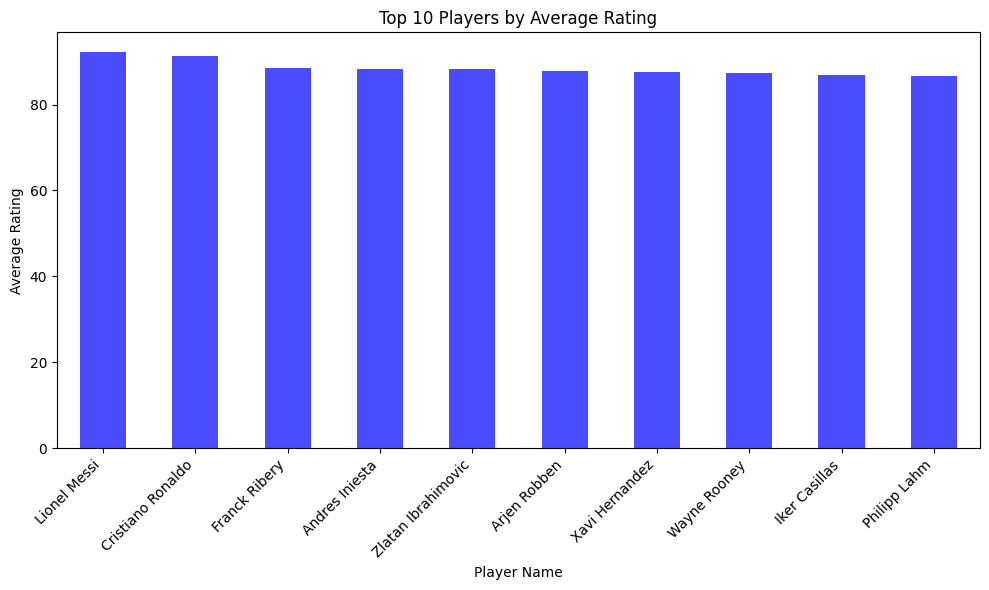

In [4]:
# Plot for top players
plt.figure(figsize=(10, 6))
top_players.plot(kind='bar', color='blue', alpha=0.7)
plt.title('Top 10 Players by Average Rating')
plt.ylabel('Average Rating')
plt.xlabel('Player Name')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

##  les equipes

In [5]:
# Équipes les plus performantes en termes de buts marqués
team_performance = matches_df.groupby('home_team_api_id')['home_team_goal'].sum() + matches_df.groupby('away_team_api_id')['away_team_goal'].sum()
top_teams = team_performance.sort_values(ascending=False).head(10)
print("\nTop 10 Teams by Total Goals:")
print(top_teams)

# Styles de jeu des équipes
team_styles = teams_df[['team_long_name', 'buildUpPlaySpeed', 'defencePressure']].drop_duplicates().head(10)
print("\nTeam Styles (Sample):")
print(team_styles)



Top 10 Teams by Total Goals:
8456     2279.0
8455     2230.0
9823     2208.0
10260    2179.0
9825     2154.0
8650     2018.0
9789     1909.0
8586     1823.0
8178     1658.0
8668     1614.0
dtype: float64

Team Styles (Sample):
      team_long_name  buildUpPlaySpeed  defencePressure
0           KRC Genk              45.0             70.0
1           KRC Genk              66.0             48.0
2           KRC Genk              53.0             47.0
3           KRC Genk              58.0             47.0
5           KRC Genk              58.0             36.0
6       Beerschot AC              35.0             70.0
7       Beerschot AC              47.0             33.0
8       Beerschot AC              55.0             45.0
9       Beerschot AC              47.0             45.0
10  SV Zulte-Waregem              65.0             70.0


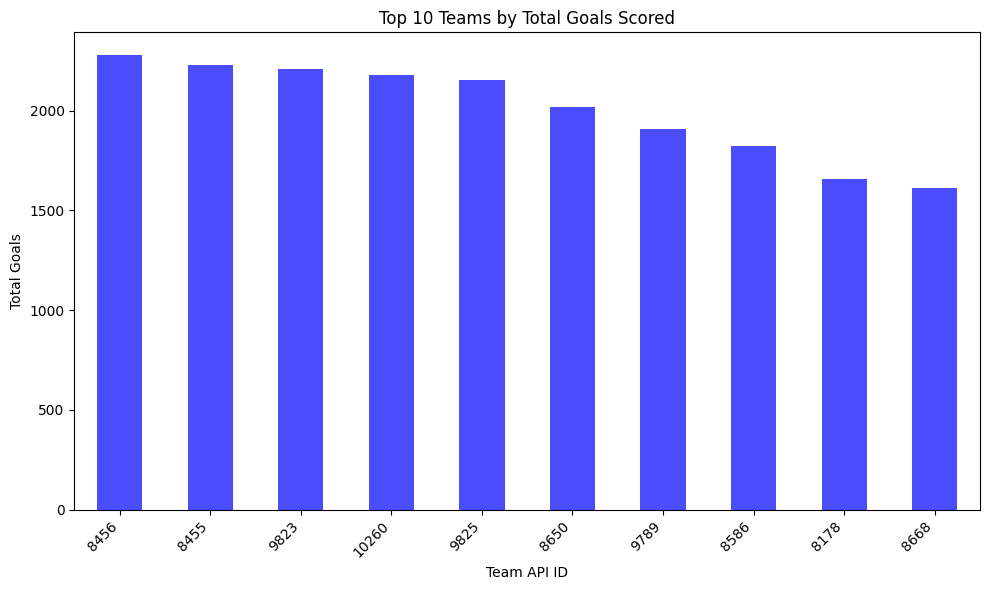

In [7]:
import matplotlib.pyplot as plt

# Calcul des buts par équipe
team_home_goals = matches_df.groupby('home_team_api_id')['home_team_goal'].sum()
team_away_goals = matches_df.groupby('away_team_api_id')['away_team_goal'].sum()
team_performance = (team_home_goals + team_away_goals).sort_values(ascending=False).head(10)

# Afficher le graphe des équipes les plus performantes
plt.figure(figsize=(10, 6))
team_performance.plot(kind='bar', color='blue', alpha=0.7)
plt.title('Top 10 Teams by Total Goals Scored')
plt.ylabel('Total Goals')
plt.xlabel('Team API ID')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


## team 

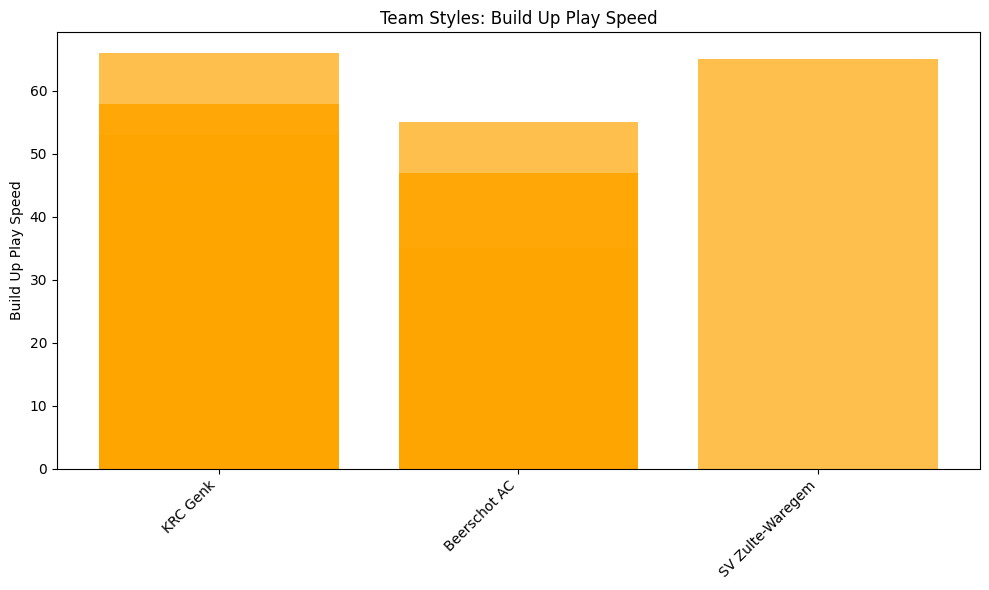

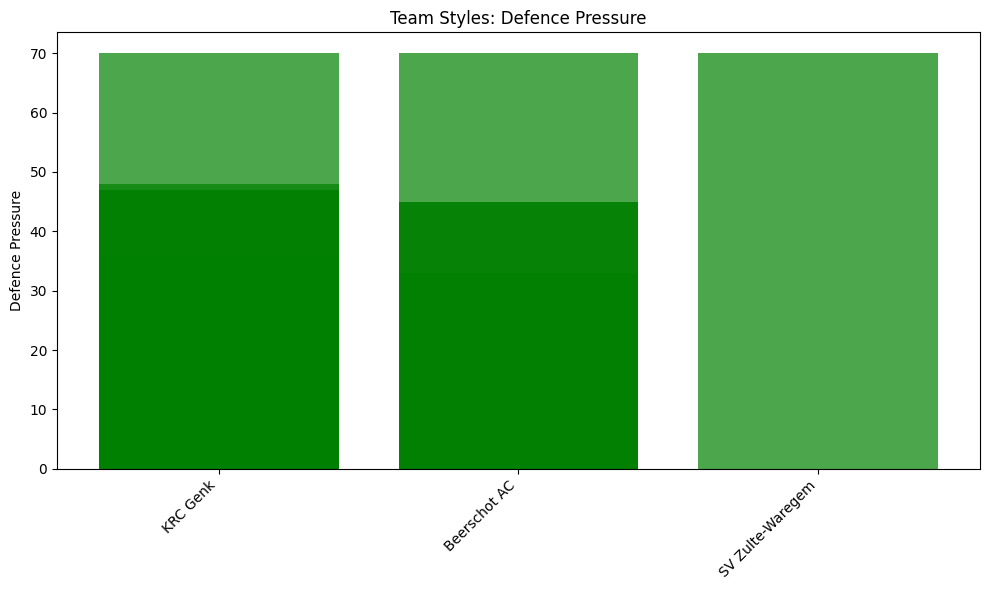

In [6]:
# Extraire les styles de jeu
team_styles = teams_df[['team_long_name', 'buildUpPlaySpeed', 'defencePressure']].drop_duplicates().head(10)

# Graphe des styles de jeu : Build Up Play Speed
plt.figure(figsize=(10, 6))
plt.bar(team_styles['team_long_name'], team_styles['buildUpPlaySpeed'], color='orange', alpha=0.7)
plt.title('Team Styles: Build Up Play Speed')
plt.ylabel('Build Up Play Speed')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Graphe des styles de jeu : Defence Pressure
plt.figure(figsize=(10, 6))
plt.bar(team_styles['team_long_name'], team_styles['defencePressure'], color='green', alpha=0.7)
plt.title('Team Styles: Defence Pressure')
plt.ylabel('Defence Pressure')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


## Analyse des matchs

In [7]:
# Calculer le nombre total de buts pour chaque match
matches_df['total_goals'] = matches_df['home_team_goal'] + matches_df['away_team_goal']
high_scoring_matches = matches_df.sort_values('total_goals', ascending=False).head(10)

print("Matchs avec le plus grand nombre de buts :")
print(high_scoring_matches)


Matchs avec le plus grand nombre de buts :
       id_match  country_id  league_id     season                 date  stage  \
23180      9211        7809       7809  2012/2013  2013-03-30 00:00:00     27   
23182      9211        7809       7809  2012/2013  2013-03-30 00:00:00     27   
23181      9211        7809       7809  2012/2013  2013-03-30 00:00:00     27   
23179      9211        7809       7809  2012/2013  2013-03-30 00:00:00     27   
4949       3093        1729       1729  2011/2012  2011-08-28 00:00:00      3   
5966       3369        1729       1729  2012/2013  2012-12-29 00:00:00     20   
5967       3369        1729       1729  2012/2013  2012-12-29 00:00:00     20   
1547       2157        1729       1729  2009/2010  2009-11-22 00:00:00     13   
1546       2157        1729       1729  2009/2010  2009-11-22 00:00:00     13   
1545       2157        1729       1729  2009/2010  2009-11-22 00:00:00     13   

       match_api_id  HomePos  home_team_api_id     home_team_name

## Comparer les performances domicile/extérieur

Moyenne des buts marqués à domicile et à l'extérieur :
home_team_goal    1.545300
away_team_goal    1.157088
dtype: float64


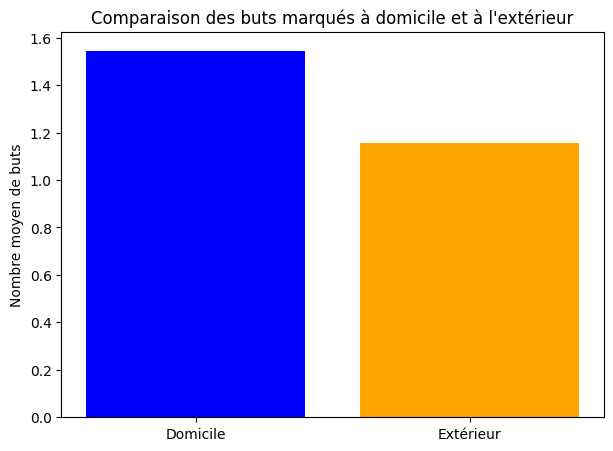

In [8]:
# Moyenne des buts marqués à domicile et à l'extérieur
average_goals = matches_df[['home_team_goal', 'away_team_goal']].mean()
print("Moyenne des buts marqués à domicile et à l'extérieur :")
print(average_goals)

# Visualisation des buts marqués domicile/extérieur
plt.figure(figsize=(7, 5))
plt.bar(['Domicile', 'Extérieur'], [average_goals['home_team_goal'], average_goals['away_team_goal']], color=['blue', 'orange'])
plt.title("Comparaison des buts marqués à domicile et à l'extérieur")
plt.ylabel("Nombre moyen de buts")
plt.show()


##  Clustering (Regroupement)

a. Clustering des joueurs

Clustering des joueurs :
          player_name  cluster
0  Aaron Appindangoye        2
1  Aaron Appindangoye        2
2  Aaron Appindangoye        1
3  Aaron Appindangoye        1
4  Aaron Appindangoye        1
5     Aaron Cresswell        0
6     Aaron Cresswell        0
7     Aaron Cresswell        0
8     Aaron Cresswell        0
9     Aaron Cresswell        0


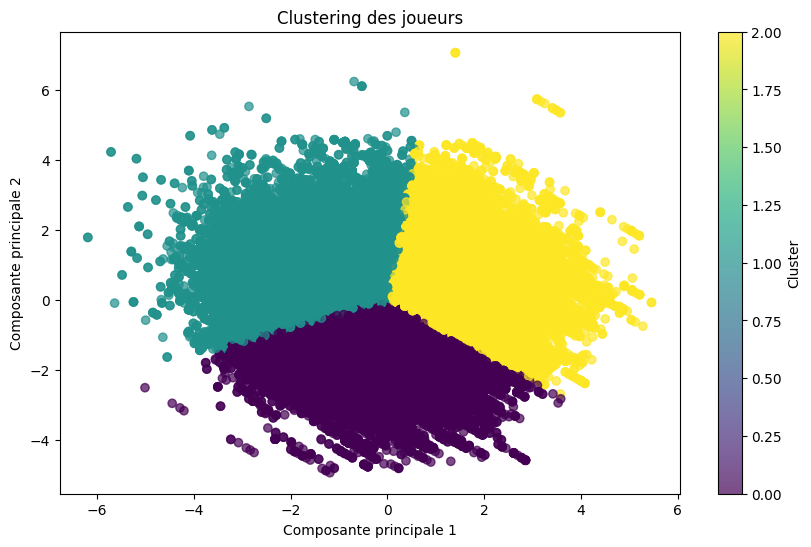

In [9]:
# Préparation des données pour le clustering
player_features = players_df[['overall_rating', 'potential', 'height', 'weight']].dropna()
scaler = StandardScaler()
scaled_features = scaler.fit_transform(player_features)

# Application de K-Means
kmeans = KMeans(n_clusters=3, random_state=42)
players_df['cluster'] = kmeans.fit_predict(scaled_features)

print("Clustering des joueurs :")
print(players_df[['player_name', 'cluster']].head(10))

# Visualisation des clusters de joueurs
pca = PCA(n_components=2)
reduced_features = pca.fit_transform(scaled_features)

plt.figure(figsize=(10, 6))
plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=players_df['cluster'], cmap='viridis', alpha=0.7)
plt.title("Clustering des joueurs")
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.colorbar(label='Cluster')
plt.show()


b. Clustering des équipes



Clustering des équipes :
  team_long_name  cluster
0       KRC Genk        0
1       KRC Genk        2
2       KRC Genk        1
3       KRC Genk        2
4       KRC Genk        2
5       KRC Genk        1
6   Beerschot AC        0
7   Beerschot AC        0
8   Beerschot AC        1
9   Beerschot AC        0


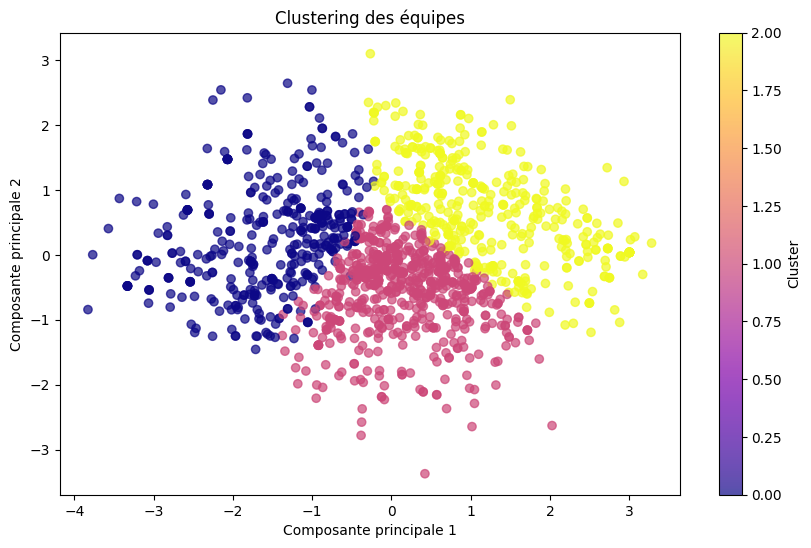

In [11]:
# Préparation des données pour le clustering des équipes
team_features = teams_df[['buildUpPlaySpeed', 'buildUpPlayPassing', 'chanceCreationPassing']].dropna()
scaled_team_features = scaler.fit_transform(team_features)

# Application de K-Means
kmeans_teams = KMeans(n_clusters=3, random_state=42)
teams_df['cluster'] = kmeans_teams.fit_predict(scaled_team_features)

print("Clustering des équipes :")
print(teams_df[['team_long_name', 'cluster']].head(10))

# Visualisation des clusters des équipes
pca_teams = PCA(n_components=2)
reduced_team_features = pca_teams.fit_transform(scaled_team_features)

plt.figure(figsize=(10, 6))
plt.scatter(reduced_team_features[:, 0], reduced_team_features[:, 1], c=teams_df['cluster'], cmap='plasma', alpha=0.7)
plt.title("Clustering des équipes")
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.colorbar(label='Cluster')
plt.show()


## 5 -

a. Classement des Meilleurs Joueurs


In [13]:
# Classement des Meilleurs Joueurs
players_df['performance_metric'] = (
    0.5 * players_df['overall_rating'] +
    0.3 * players_df['potential'] +
    0.1 * players_df['short_passing'] +
    0.1 * players_df['standing_tackle']
)

best_players = players_df.nlargest(10, "performance_metric")[["player_name", "performance_metric"]]
print("Classement des Meilleurs Joueurs :")
print(best_players)


Classement des Meilleurs Joueurs :
             player_name  performance_metric
59279      Frank Lampard                90.4
53197    Fabio Cannavaro                89.7
180723    Xavi Hernandez                89.5
123021    Michael Essien                89.1
62988       Gerard Pique                89.1
62989       Gerard Pique                89.1
167137    Steven Gerrard                89.1
32564               Cris                88.9
107705  Mahamadou Diarra                88.9
180722    Xavi Hernandez                88.7


b. Classement des Équipes Dominantes


In [14]:
# Classement des Équipes Dominantes
matches_df['home_win'] = matches_df['home_team_goal'] > matches_df['away_team_goal']
matches_df['away_win'] = matches_df['away_team_goal'] > matches_df['home_team_goal']
dominating_teams = (
    matches_df.groupby("home_team_name")["home_win"].sum() +
    matches_df.groupby("away_team_name")["away_win"].sum()
).sort_values(ascending=False)

print("\nClassement des Équipes Dominantes :")
print(dominating_teams.head(10))



Classement des Équipes Dominantes :
Manchester United      737.0
Manchester City        665.0
FC Bayern Munich       657.0
Chelsea                654.0
Arsenal                636.0
Tottenham Hotspur      571.0
Liverpool              562.0
Borussia Dortmund      551.0
Bayer 04 Leverkusen    473.0
Paris Saint-Germain    443.0
dtype: float64


c. Classement des Matchs à Haut Score


In [15]:
# Classement des Matchs à Haut Score
matches_df['total_goals'] = matches_df['home_team_goal'] + matches_df['away_team_goal']
high_scoring_matches = matches_df.nlargest(10, "total_goals")[["home_team_name", "away_team_name", "total_goals"]]
print("\nClassement des Matchs à Haut Score :")
print(high_scoring_matches)



Classement des Matchs à Haut Score :
          home_team_name  away_team_name  total_goals
23179   FC Bayern Munich    Hamburger SV           11
23180   FC Bayern Munich    Hamburger SV           11
23181   FC Bayern Munich    Hamburger SV           11
23182   FC Bayern Munich    Hamburger SV           11
1545   Tottenham Hotspur  Wigan Athletic           10
1546   Tottenham Hotspur  Wigan Athletic           10
1547   Tottenham Hotspur  Wigan Athletic           10
1548   Tottenham Hotspur  Wigan Athletic           10
4948   Manchester United         Arsenal           10
4949   Manchester United         Arsenal           10


## Graphiques et Visualisations


a. Diagrammes pour les Performances des Équipes


In [16]:
import plotly.graph_objects as go

# Diagramme pour les performances des équipes
fig = go.Figure()
fig.add_trace(go.Bar(x=dominating_teams.index[:10], y=dominating_teams.values[:10]))
fig.update_layout(title="Performances des Équipes Dominantes", 
                  xaxis_title="Équipes", 
                  yaxis_title="Victoires", 
                  template="plotly_dark")
fig.show()


b. Scatter Plot des Clusters des Joueurs


In [17]:
import plotly.express as px

# Visualisation des clusters des joueurs
fig = px.scatter(x=reduced_features[:, 0], y=reduced_features[:, 1], 
                 color=players_df['cluster'].astype(str), 
                 hover_data={'player_name': players_df['player_name']}, 
                 title="Clusters des Joueurs",
                 labels={"x": "Composante Principale 1", "y": "Composante Principale 2", "color": "Cluster"},
                 template="plotly_dark")
fig.show()


c. Scatter Plot des Clusters des Équipes


In [19]:
# Visualisation des clusters des équipes
fig = px.scatter(x=reduced_team_features[:, 0], y=reduced_team_features[:, 1], 
                 color=teams_df['cluster'].astype(str), 
                 hover_data={'team_long_name': teams_df['team_long_name']}, 
                 title="Clusters des Équipes",
                 labels={"x": "Composante Principale 1", "y": "Composante Principale 2", "color": "Cluster"},
                 template="plotly_dark")
fig.show()
